In [6]:
%pip install imgaug

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 948.0/948.0 kB 13.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.0/15.0 MB 22.2 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 24.2 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


In [ ]:
import numpy as np
import imgaug as ia
import imgaug.augmenters as iaa


ia.seed(1)

# Example batch of images.
# The array has shape (32, 64, 64, 3) and dtype uint8.
images = np.array(
    [ia.quokka(size=(64, 64)) for _ in range(32)],
    dtype=np.uint8
)

seq = iaa.Sequential([
    # iaa.Fliplr(0.5), # horizontal flips
    iaa.Crop(percent=(0, 0.1)), # random crops
    # Small gaussian blur with random sigma between 0 and 0.5.
    # But we only blur about 50% of all images.
    iaa.Sometimes(
        0.5,
        iaa.GaussianBlur(sigma=(0, 0.5))
    ),
    # Strengthen or weaken the contrast in each image.
    iaa.LinearContrast((0.75, 1.5)),
    # Add gaussian noise.
    # For 50% of all images, we sample the noise once per pixel.
    # For the other 50% of all images, we sample the noise per pixel AND
    # channel. This can change the color (not only brightness) of the
    # pixels.
    iaa.AdditiveGaussianNoise(loc=0, scale=(0.0, 0.05*255), per_channel=0.5),
    # Make some images brighter and some darker.
    # In 20% of all cases, we sample the multiplier once per channel,
    # which can end up changing the color of the images.
    iaa.Multiply((0.8, 1.2), per_channel=0.2),
    # Apply affine transformations to each image.
    # Scale/zoom them, translate/move them, rotate them and shear them.
    # iaa.Affine(
    #     scale={"x": (0.8, 1.2), "y": (0.8, 1.2)},
    #     translate_percent={"x": (-0.2, 0.2), "y": (-0.2, 0.2)},
    #     rotate=(-25, 25),
    #     shear=(-8, 8)
    # )
], random_order=True) # apply augmenters in random order

images_aug = seq(images=images)

<class 'numpy.ndarray'>


In [21]:
type(images_aug)

numpy.ndarray

In [19]:
import matplotlib.pyplot as plt

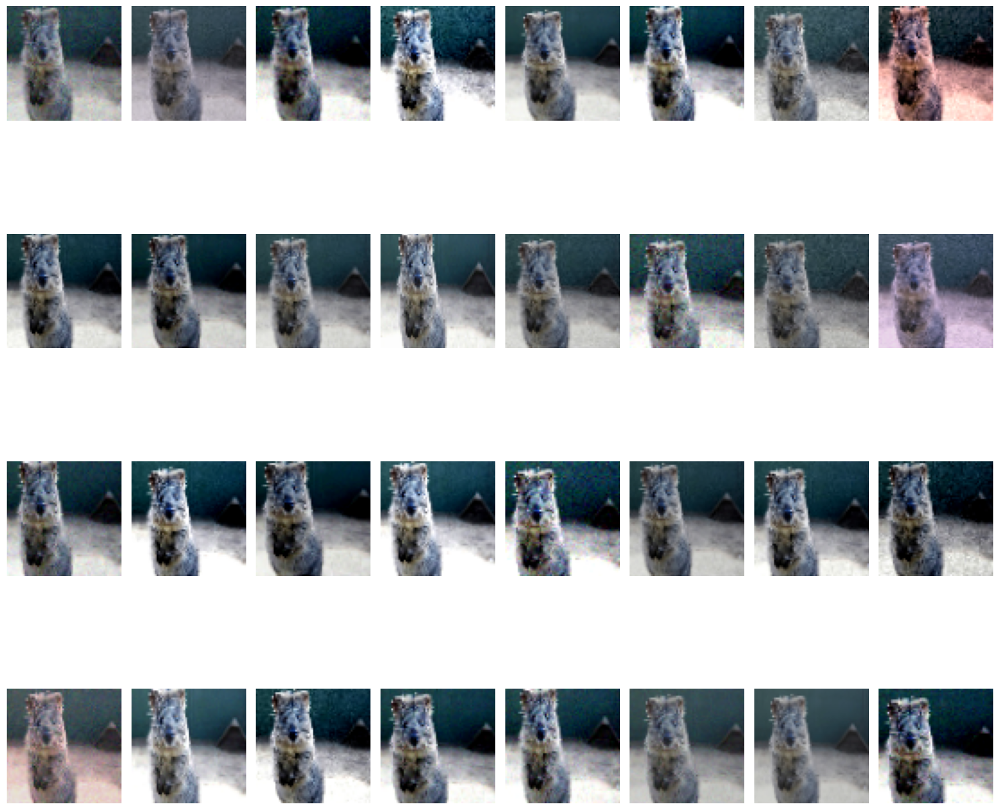

In [20]:
# Show images_aug in a grid
def show_grid(images, cols=4):
    rows = len(images) // cols + (len(images) % cols > 0)
    fig, axes = plt.subplots(rows, cols, figsize=(15, 15))
    for i, ax in enumerate(axes.flat):
        if i < len(images):
            ax.imshow(images[i])
        ax.axis('off')
    plt.tight_layout()
    plt.show()
show_grid(images_aug, cols=8)

In [1]:
from denoiser_wgans import train_wgan

/home/fred/anaconda3/envs/py-tf-torch-env/lib/python3.12/site-packages/torch/utils/_pytree.py:185: FutureWarning: optree is installed but the version is too old to support PyTorch Dynamo in C++ pytree. C++ pytree support is disabled. Please consider upgrading optree using `python3 -m pip install --upgrade 'optree>=0.13.0'`.
  warnings.warn(


/home/fred/humber/em_tech/final_project/denoiser_wgans.py:93: UserWarning: The torch.cuda.*DtypeTensor constructors are no longer recommended. It's best to use methods such as torch.tensor(data, dtype=*, device='cuda') to create tensors. (Triggered internally at /pytorch/torch/csrc/tensor/python_tensor.cpp:78.)
  alpha = Tensor(np.random.random((real_samples.size(0), 1, 1, 1)))


[Epoch 0/50] [Batch 30/31] [D loss: 7.5521] [G loss: 1.7592]
[Epoch 1/50] [Batch 30/31] [D loss: -58.2690] [G loss: 42.0402]
[Epoch 2/50] [Batch 30/31] [D loss: -347.9156] [G loss: 141.0253]
[Epoch 3/50] [Batch 30/31] [D loss: -568.5725] [G loss: 218.8570]
[Epoch 4/50] [Batch 30/31] [D loss: -502.8980] [G loss: 202.0693]Generated images


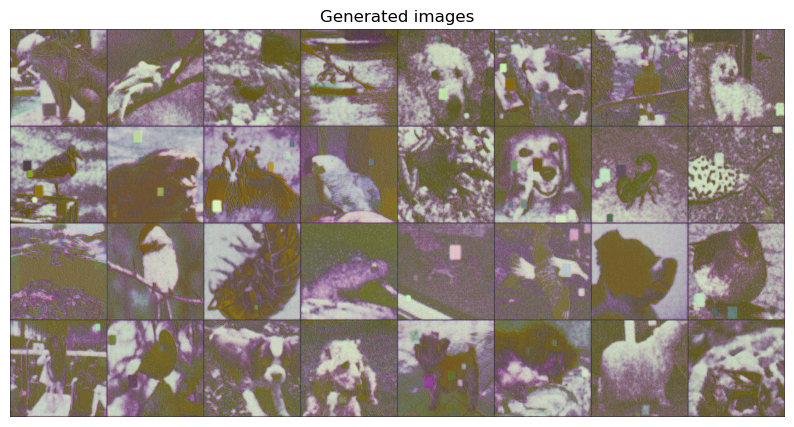

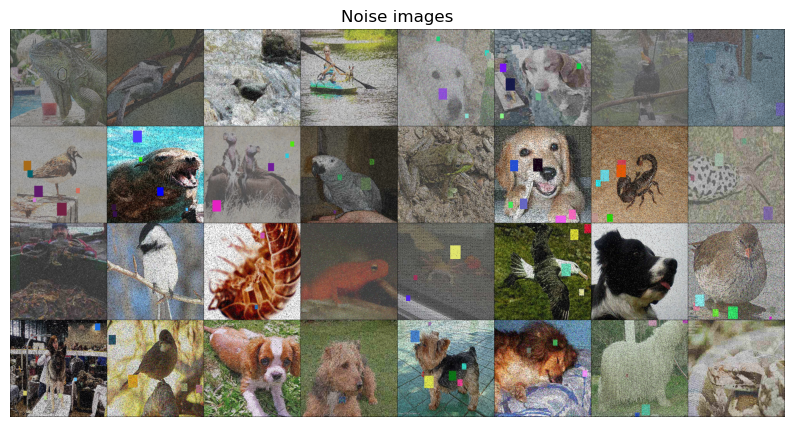


[Epoch 5/50] [Batch 30/31] [D loss: -367.3091] [G loss: 86.7363]]
[Epoch 6/50] [Batch 30/31] [D loss: -351.3883] [G loss: 112.1051]
[Epoch 7/50] [Batch 30/31] [D loss: -200.1980] [G loss: 41.3262]
[Epoch 8/50] [Batch 30/31] [D loss: -101.5560] [G loss: -101.6571]
[Epoch 9/50] [Batch 30/31] [D loss: -106.6936] [G loss: 167.7602]Generated images


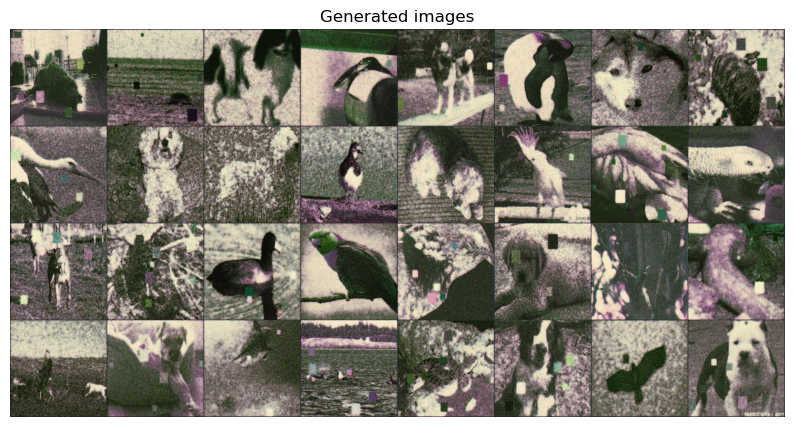

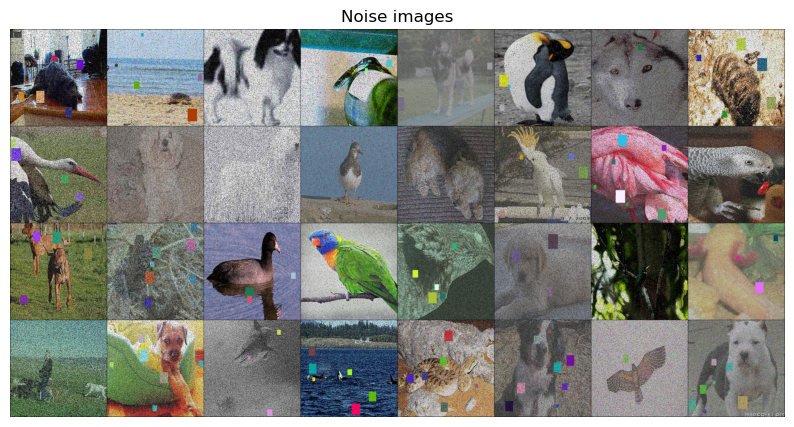


[Epoch 10/50] [Batch 30/31] [D loss: -182.6320] [G loss: 370.3157]
[Epoch 11/50] [Batch 30/31] [D loss: -226.1788] [G loss: 449.9558]
[Epoch 12/50] [Batch 30/31] [D loss: -208.2825] [G loss: 372.1098]
[Epoch 13/50] [Batch 30/31] [D loss: -165.2609] [G loss: 209.0117]
[Epoch 14/50] [Batch 30/31] [D loss: -96.0188] [G loss: 20.9421]]Generated images


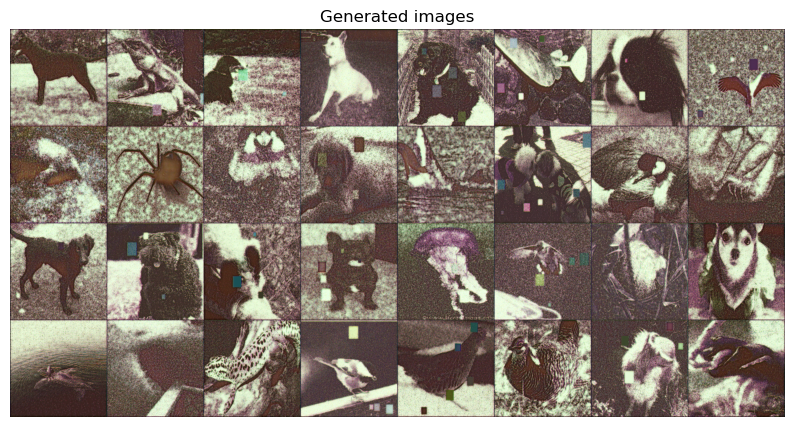

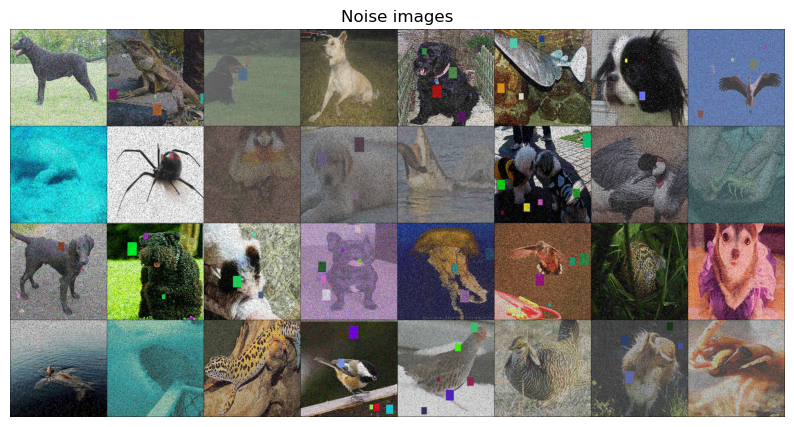


[Epoch 15/50] [Batch 30/31] [D loss: -78.6709] [G loss: -2.1866]
[Epoch 16/50] [Batch 30/31] [D loss: -55.5849] [G loss: 8.0710]]]
[Epoch 17/50] [Batch 30/31] [D loss: -98.5962] [G loss: 128.3279]
[Epoch 18/50] [Batch 30/31] [D loss: -206.2746] [G loss: 318.1559]
[Epoch 19/50] [Batch 30/31] [D loss: -247.1514] [G loss: 406.2025]Generated images


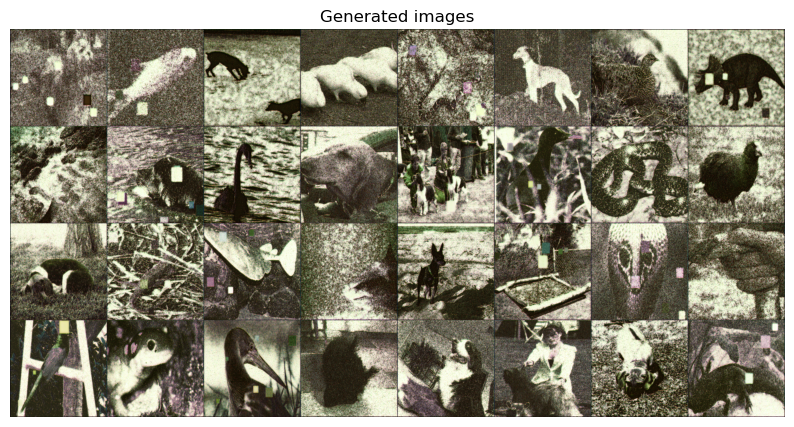

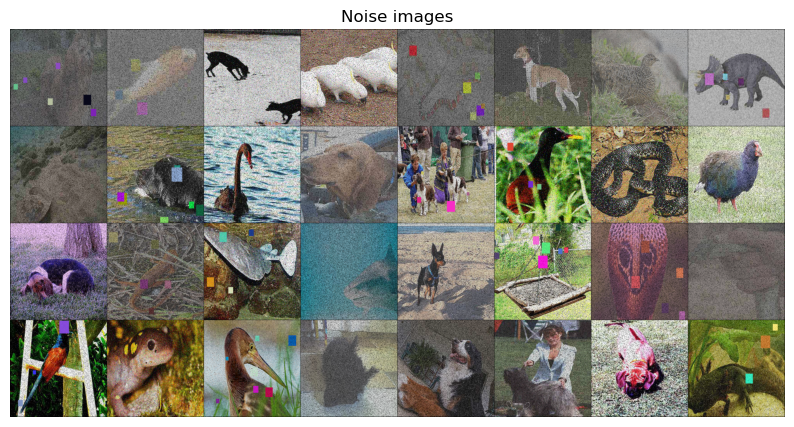


[Epoch 20/50] [Batch 30/31] [D loss: -139.1921] [G loss: 352.4633]
[Epoch 21/50] [Batch 30/31] [D loss: -65.3245] [G loss: 277.5987]]
[Epoch 22/50] [Batch 30/31] [D loss: -55.7451] [G loss: 224.5057]
[Epoch 23/50] [Batch 30/31] [D loss: -100.0738] [G loss: 247.1769]
[Epoch 24/50] [Batch 30/31] [D loss: -211.3176] [G loss: 328.4283]Generated images


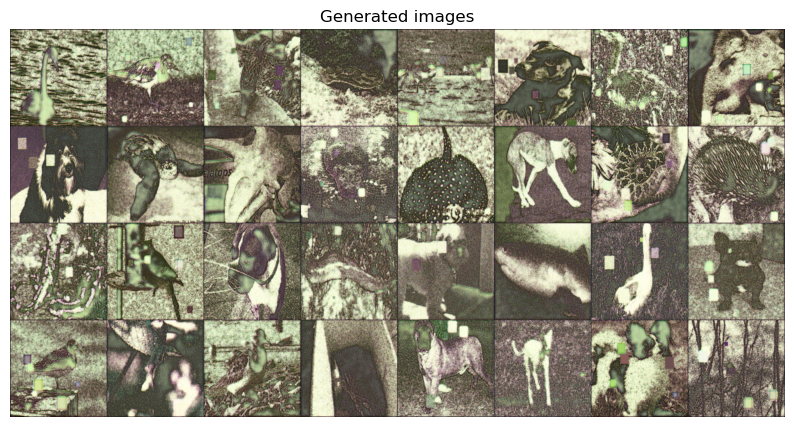

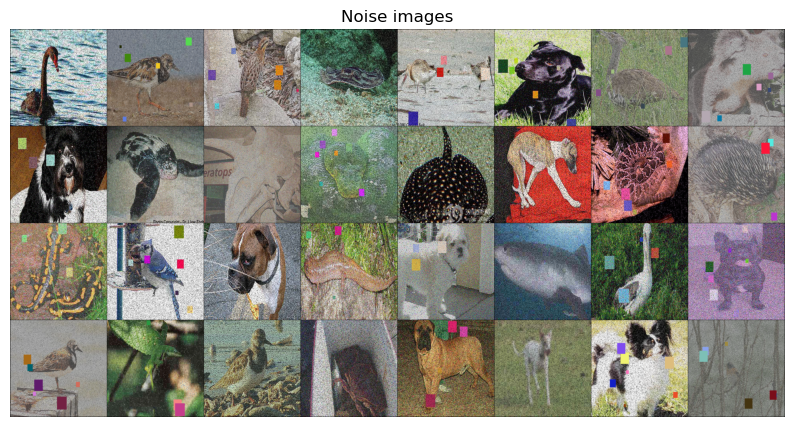


[Epoch 25/50] [Batch 30/31] [D loss: -231.0165] [G loss: 428.7815]
[Epoch 26/50] [Batch 30/31] [D loss: -262.6182] [G loss: 454.8550]
[Epoch 27/50] [Batch 30/31] [D loss: -192.4834] [G loss: 364.2035]
[Epoch 28/50] [Batch 30/31] [D loss: -215.8310] [G loss: 395.7505]
[Epoch 29/50] [Batch 30/31] [D loss: -232.1720] [G loss: 398.1622]Generated images


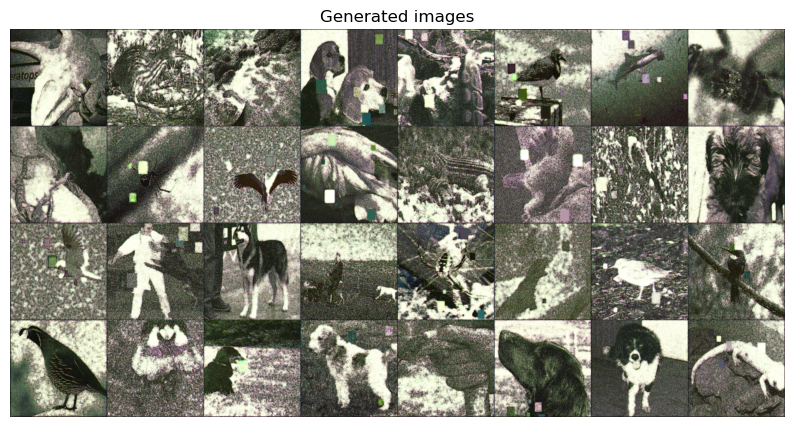

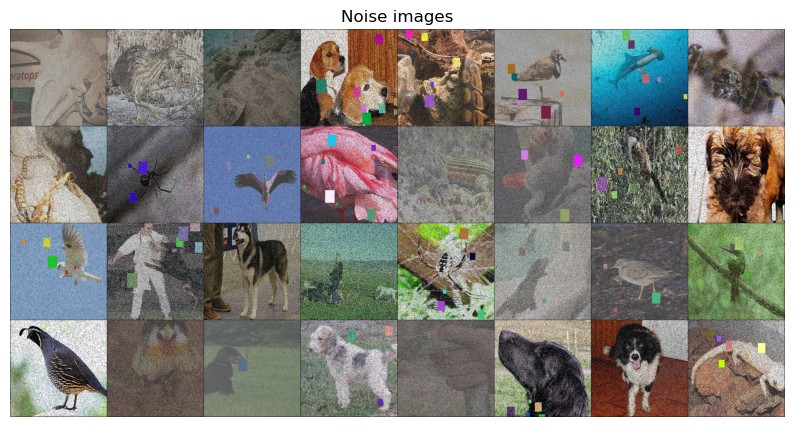


[Epoch 30/50] [Batch 30/31] [D loss: -226.9459] [G loss: 369.7244]
[Epoch 31/50] [Batch 30/31] [D loss: -175.9418] [G loss: 347.2136]
[Epoch 32/50] [Batch 30/31] [D loss: -167.1013] [G loss: 297.9703]
[Epoch 33/50] [Batch 30/31] [D loss: -131.4983] [G loss: 245.3243]
[Epoch 34/50] [Batch 30/31] [D loss: -229.5396] [G loss: 307.8715]Generated images


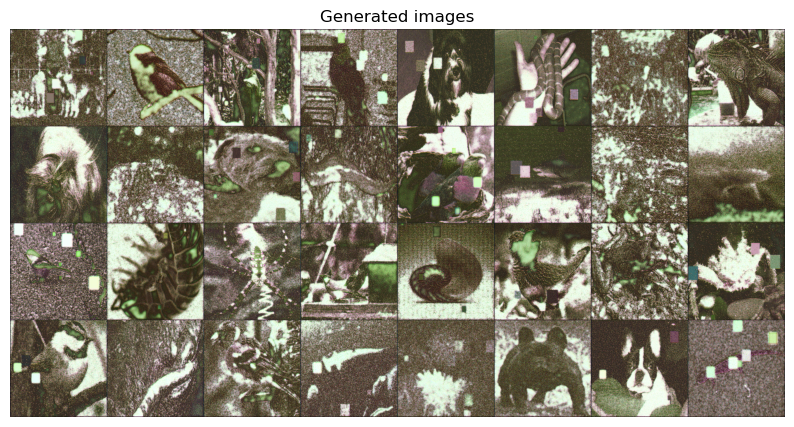

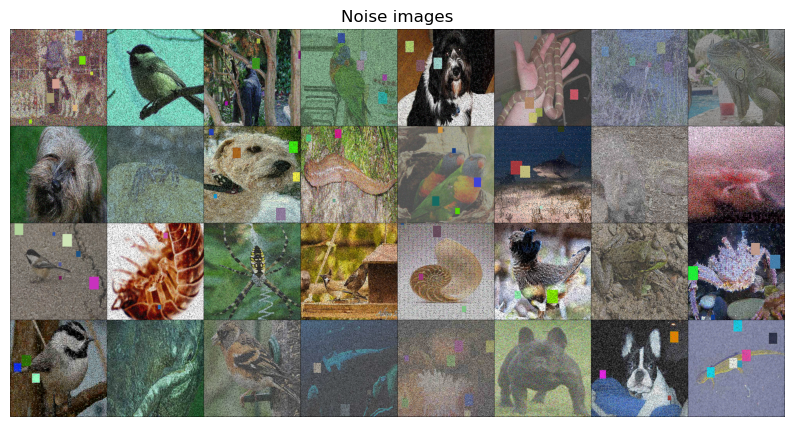


[Epoch 35/50] [Batch 30/31] [D loss: -296.8783] [G loss: 378.2648]
[Epoch 36/50] [Batch 30/31] [D loss: -252.2260] [G loss: 381.9555]
[Epoch 37/50] [Batch 30/31] [D loss: -143.0862] [G loss: 340.7282]
[Epoch 38/50] [Batch 30/31] [D loss: -134.9657] [G loss: 347.5123]
[Epoch 39/50] [Batch 30/31] [D loss: -207.6790] [G loss: 371.6552]Generated images


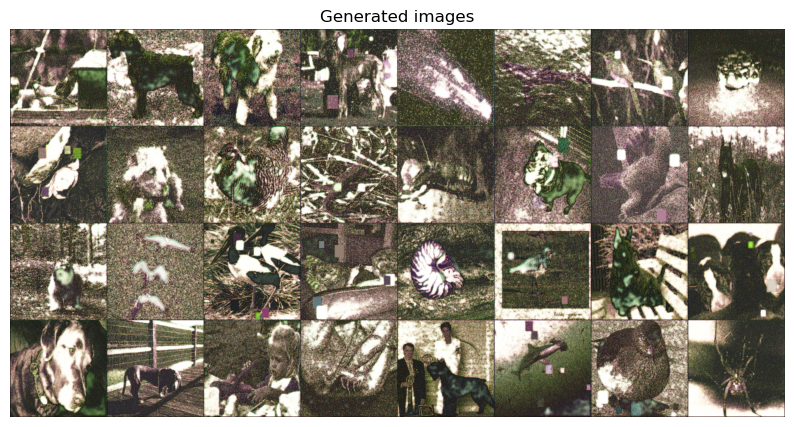

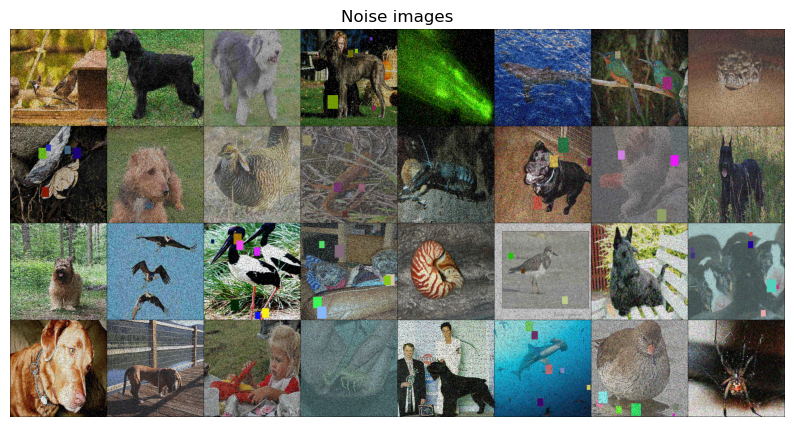


[Epoch 40/50] [Batch 30/31] [D loss: -263.0440] [G loss: 425.6203]
[Epoch 41/50] [Batch 30/31] [D loss: -240.3863] [G loss: 413.1841]
[Epoch 42/50] [Batch 30/31] [D loss: -174.2811] [G loss: 371.9537]
[Epoch 43/50] [Batch 30/31] [D loss: -144.5423] [G loss: 356.3779]
[Epoch 44/50] [Batch 30/31] [D loss: -174.9234] [G loss: 332.0099]Generated images


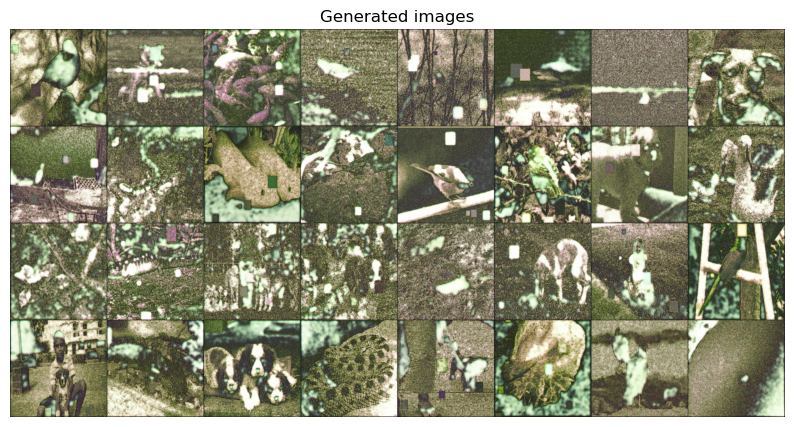

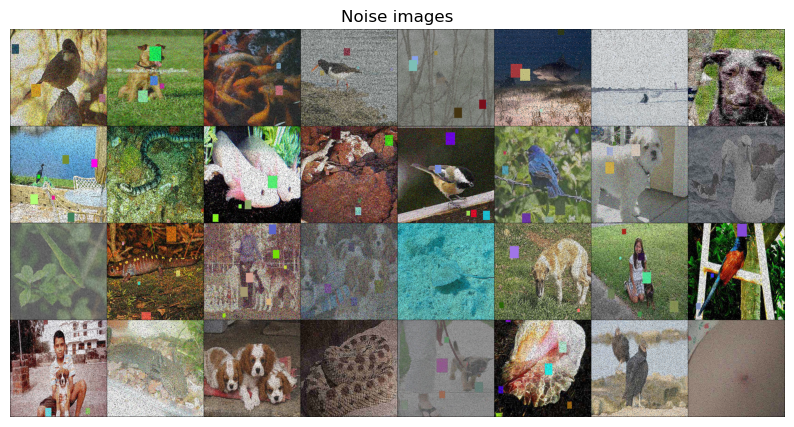


[Epoch 45/50] [Batch 30/31] [D loss: -209.8992] [G loss: 317.1677]
[Epoch 46/50] [Batch 30/31] [D loss: -219.6806] [G loss: 316.0684]
[Epoch 47/50] [Batch 30/31] [D loss: -184.0565] [G loss: 292.2104]
[Epoch 48/50] [Batch 30/31] [D loss: -156.8245] [G loss: 292.5808]
[Epoch 49/50] [Batch 30/31] [D loss: -164.4793] [G loss: 296.2305]Generated images


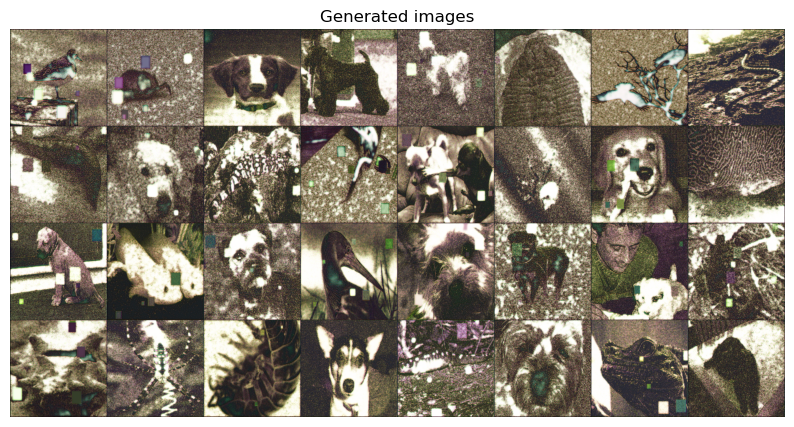

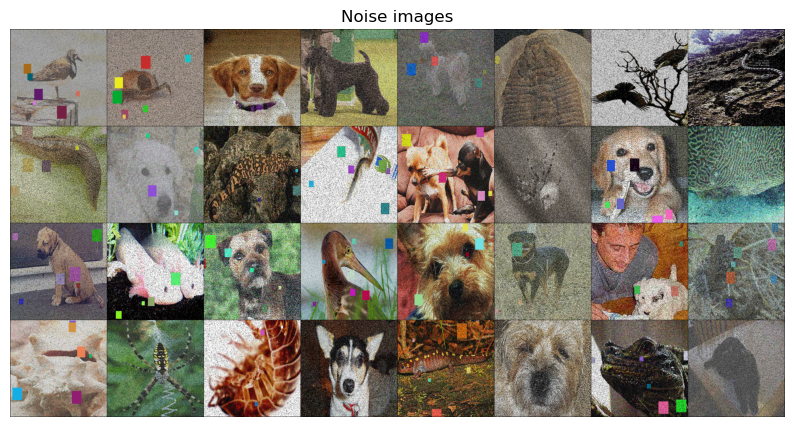

In [2]:
train_wgan(5)